# Домашняя работа по дисциплине "Классическое машинное обучение" 

## Практическое задание №5

Работу выполнил студент Груданов Николай.

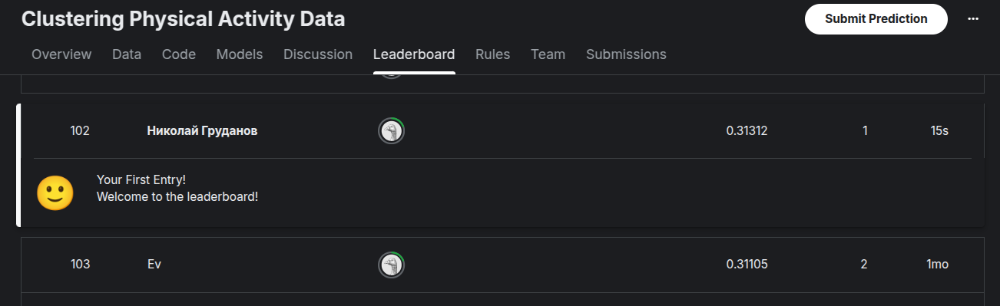

---

In [1]:
# --- Импорт необходимых библиотек ---
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.utils import resample
import torch
import torchclust
from torchclust.density import GaussianMixtureModel
import torchgmm
import tgmm
from tgmm import GaussianMixture
import seaborn as sns

# Убираем предупреждения для чистоты вывода
import warnings
warnings.filterwarnings('ignore')


In [2]:
print("Версия PyTorch:", torch.__version__)

Версия PyTorch: 2.7.0+rocm6.3


In [3]:
# Проверяем доступность GPU (ROCm)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
if device == 'cpu':
    print("Внимание: ROCm/GPU не обнаружен. Вычисления будут на CPU.")

if device == 'cuda':
    print("Вычисления будут на GPU:", torch.cuda.get_device_name(0))

    

Вычисления будут на GPU: AMD Radeon RX 7800 XT


In [4]:
# --- Загрузка данных ---
file_path = './clustering-physical-activity-data/Physical_Activity_Monitoring_unlabeled.csv'
df = pd.read_csv(file_path)

# --- Первичный осмотр данных ---
print("Размер датасета:", df.shape)
print("\nПервые 5 строк данных:")
print(df.head())

Размер датасета: (534601, 53)

Первые 5 строк данных:
   timestamp  handTemperature  handAcc16_1  handAcc16_2  handAcc16_3  \
0     252.75          34.8750     0.902847      7.45872     6.032490   
1    3652.45          29.7500    -4.069330      3.76168     8.279720   
2     504.76          34.3750    -2.007540     -9.60180     0.773674   
3    2801.61          31.9375   -13.262200      5.85443     0.899334   
4     441.01          33.5000    -0.013940      8.66540     4.398210   

   handAcc6_1  handAcc6_2  handAcc6_3  handGyro1  handGyro2  ...  ankleGyro2  \
0    1.006100     7.44575    6.303650  -0.021952   0.004114  ...   -0.025606   
1   -5.972500     3.22273    6.908970   0.116054  -0.375968  ...   -0.670163   
2   -1.803500    -9.58937    1.073680   0.020131   0.042189  ...   -0.009741   
3  -13.611500     5.91511    0.840377   1.715630  -0.050492  ...   -0.163470   
4    0.144153     8.56816    4.822200  -0.006938  -0.007383  ...   -0.028172   

   ankleGyro3  ankleMagne1  ankl

In [5]:
df.shape

(534601, 53)

Предобработка и анализ данных (EDA)

In [6]:
# --- Предобработка данных ---

# Проверка на пропущенные значения
print("\nПроверка на пропущенные значения:")
print(df.isnull().sum().sum()) # Выводим общее количество NaN

# Поскольку в данных могут быть ошибки чтения или бесконечные значения, заменим их на NaN
df.replace([np.inf, -np.inf], np.nan, inplace=True)
# Простое решение - заполнение пропусков средним значением по столбцу
df.fillna(df.mean(), inplace=True)

# Проверим еще раз
print("Пропущенных значений после обработки:", df.isnull().sum().sum())


# Удалим столбец 'timestamp', так как для кластеризации отдельных записей он не нужен.
# 'subject_id' также уберем из обучающего набора, чтобы модель не "подстраивалась" под конкретного пользователя.
X = df.drop(columns=['timestamp', 'subject_id'])

# --- Масштабирование признаков ---
# Это обязательный шаг для алгоритмов, использующих метрики расстояния.
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Преобразуем обратно в DataFrame для удобства
X_scaled = pd.DataFrame(X_scaled, columns=X.columns)

print("\nДанные после масштабирования:")
print(X_scaled.head())



Проверка на пропущенные значения:
125732
Пропущенных значений после обработки: 0

Данные после масштабирования:
   handTemperature  handAcc16_1  handAcc16_2  handAcc16_3  handAcc6_1  \
0         1.386442     0.758769     0.585934     0.511722    0.764251   
1        -1.545144     0.052017     0.072218     1.100504   -0.226720   
2         1.100434     0.345083    -1.784680    -0.866105    0.365284   
3        -0.293857    -1.254669     0.363012    -0.833181   -1.311468   
4         0.599919     0.628456     0.753606     0.083536    0.641853   

   handAcc6_2  handAcc6_3  handGyro1  handGyro2  handGyro3  ...  ankleGyro1  \
0    0.618166    0.536072  -0.011335  -0.026738  -0.000476  ...    0.027362   
1    0.000655    0.695050   0.108077  -0.438384  -0.008014  ...   -0.352062   
2   -1.872793   -0.837497   0.025078   0.014499  -0.007155  ...    0.050036   
3    0.394348   -0.898770   1.492130  -0.085878  -1.135812  ...    3.084633   
4    0.782290    0.146993   0.001656  -0.039189  -0.0

Уменьшение размерности с помощью PCA

Метод главных компонент (PCA) преобразует многомерное пространство признаков в новое пространство с меньшим числом измерений.

In [7]:
# --- Применение PCA для ---

# Создаем объект PCA. n_components=2 для последующей 2D-визуализации.
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_scaled)

print(f"\nОбъясненная дисперсия первыми двумя компонентами: {sum(pca.explained_variance_ratio_)*100:.2f}%")

# Создаем DataFrame с результатами PCA
X_pca_df = pd.DataFrame(data=X_pca, columns=['PCA1', 'PCA2'])
print("Данные после PCA:")
print(X_pca_df.head())



Объясненная дисперсия первыми двумя компонентами: 25.44%
Данные после PCA:
       PCA1      PCA2
0  5.830980  0.391775
1 -0.679148 -3.900695
2  0.042399  2.554949
3 -3.709360  1.514120
4  0.517058 -0.556396


Обучение модели K-Means

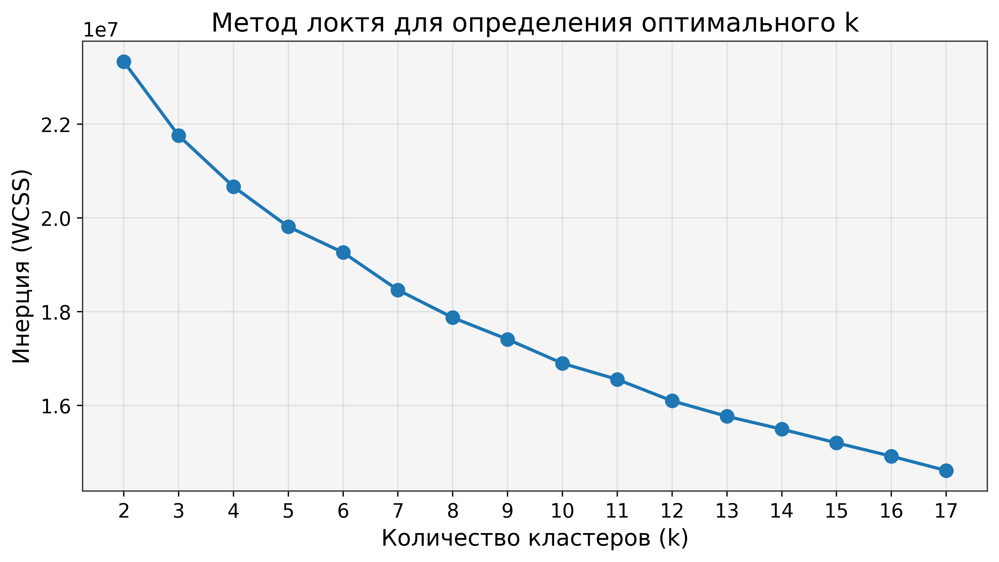

In [8]:
# --- Определение оптимального количества кластеров (k) для K-Means ---

# 1. Метод локтя (Elbow Method)
inertia = []
k_range = range(2, 18) # Проверим количество кластеров от 2 до 17

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(X_scaled) # Используем масштабированные данные
    inertia.append(kmeans.inertia_)

# Визуализация метода локтя
plt.figure(figsize=(10, 5))
plt.plot(k_range, inertia, marker='o')
plt.title('Метод локтя для определения оптимального k')
plt.xlabel('Количество кластеров (k)')
plt.ylabel('Инерция (WCSS)')
plt.xticks(k_range)
plt.grid(True)
plt.show()




**Анализ графика "Метод локтя"**

**Что мы видим на графике:**
*   Кривая достаточно плавная, без резкого, очевидного "локтя". Это говорит о том, что в данных нет очень четко выраженной кластерной структуры.
*   Наиболее заметное снижение инерции происходит на участке от `k=2` до `k=4`.
*   После `k=5` или `k=6` линия становится более пологой, и каждое следующее добавление кластера уменьшает инерцию примерно на одинаковую величину.

**Вывод по методу локтя:** Оптимальное значение `k`, скорее всего, находится в диапазоне **от 4 до 6**. Эти значения можно считать кандидатами.



Проверим методом 

In [9]:
# 2. Анализ по Silhouette Score

silhouette_scores = []
# Определим размер выборки.
sample_size = 70000
k_range = range(2, 18)

print(f"Начинаем расчет Silhouette Score на выборке размером {sample_size}...")

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(X_scaled)
    
    score = silhouette_score(X_scaled, labels, sample_size=sample_size, random_state=42)
    
    silhouette_scores.append(score)
    print(f"k={k}, Silhouette Score: {score:.4f}")

print("Расчет завершен.")


Начинаем расчет Silhouette Score на выборке размером 70000...
k=2, Silhouette Score: 0.1846
k=3, Silhouette Score: 0.1509
k=4, Silhouette Score: 0.1582
k=5, Silhouette Score: 0.1089
k=6, Silhouette Score: 0.1450
k=7, Silhouette Score: 0.1223
k=8, Silhouette Score: 0.1401
k=9, Silhouette Score: 0.1505
k=10, Silhouette Score: 0.1548
k=11, Silhouette Score: 0.1462
k=12, Silhouette Score: 0.1677
k=13, Silhouette Score: 0.1718
k=14, Silhouette Score: 0.1822
k=15, Silhouette Score: 0.1673
k=16, Silhouette Score: 0.1783
k=17, Silhouette Score: 0.1983
Расчет завершен.


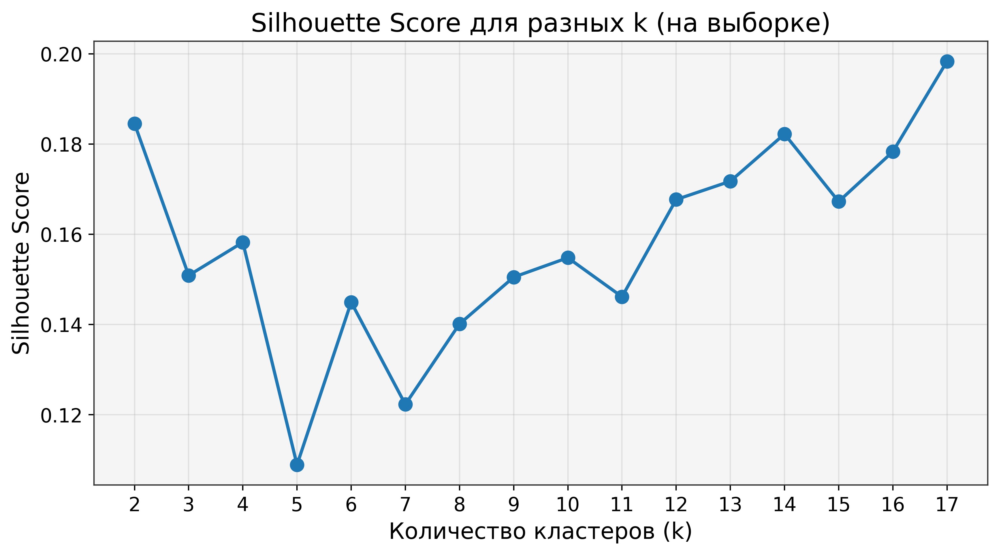

In [10]:
# Визуализация результатов
plt.figure(figsize=(10, 5))
plt.plot(k_range, silhouette_scores, marker='o')
plt.title('Silhouette Score для разных k (на выборке)')
plt.xlabel('Количество кластеров (k)')
plt.ylabel('Silhouette Score')
plt.xticks(k_range)
plt.grid(True)
plt.show()

**Анализ графика "Silhouette Score"**

**Что мы видим на графике:**
*   **Максимум при k=2**: Самое высокое значение (около 0.18) достигается при двух кластерах. Это значит, что с точки зрения метрики, лучше всего данные делятся на две большие группы (например, "активность" и "покой").
*   **Пики**: Есть заметные пики при **k=4**, **k=10** и **k=12**, **k=15-17**.
*   **Сильный провал при k=5**: Это говорит о том, что 5 кластеров — плохой выбор.
*   **Низкие значения в целом**: Важно отметить, что все значения Silhouette Score довольно низкие (значительно ниже 0.5). Это подтверждает вывод "метода локтя": кластеры в данных, скорее всего, сильно пересекаются и не имеют четких границ.


**Сводный анализ и рекомендация**

Итак, у нас есть противоречивые сигналы:
*   **Метод локтя** намекает на `k` в районе 4-6.
*   **Silhouette Score** дает самый высокий балл для `k=2` и `k=17` , но также показывает локальные пики при `k=4` и в районе `k=12-14`.


**Выбор `k=4` (Сбалансированный компромисс):**
Это значение является локальным пиком на графике Silhouette Score и одновременно попадает в предполагаемую "локтевую" зону первого графика. Провал при `k=5` дополнительно усиливает позицию `k=4` как разумной точки "стабилизации" перед плохим разбиением.вероятно, получится выделить осмысленные группы активностей, например: "покой", "ходьба", "бег", "другая активность". Делать разбиение на покой и не покой выглядит плохой идей. Хотя максимальное значение Silhouette Score было достигнуто при `k=17`, был выбран вариант с `k=4`, поскольку он обеспечивает наиболее четкое и практически значимое разделение данных на интерпретируемые группы.


In [11]:
# --- Обучение финальной модели K-Means ---

optimal_k = 4 # Оптимальное k из предыдущего анализа
kmeans_final = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
kmeans_labels = kmeans_final.fit_predict(X_scaled)

# Добавляем метки кластеров в PCA-DataFrame для визуализации
X_pca_df['KMeans_Labels'] = kmeans_labels

Визуализация и оценка результатов K-Means

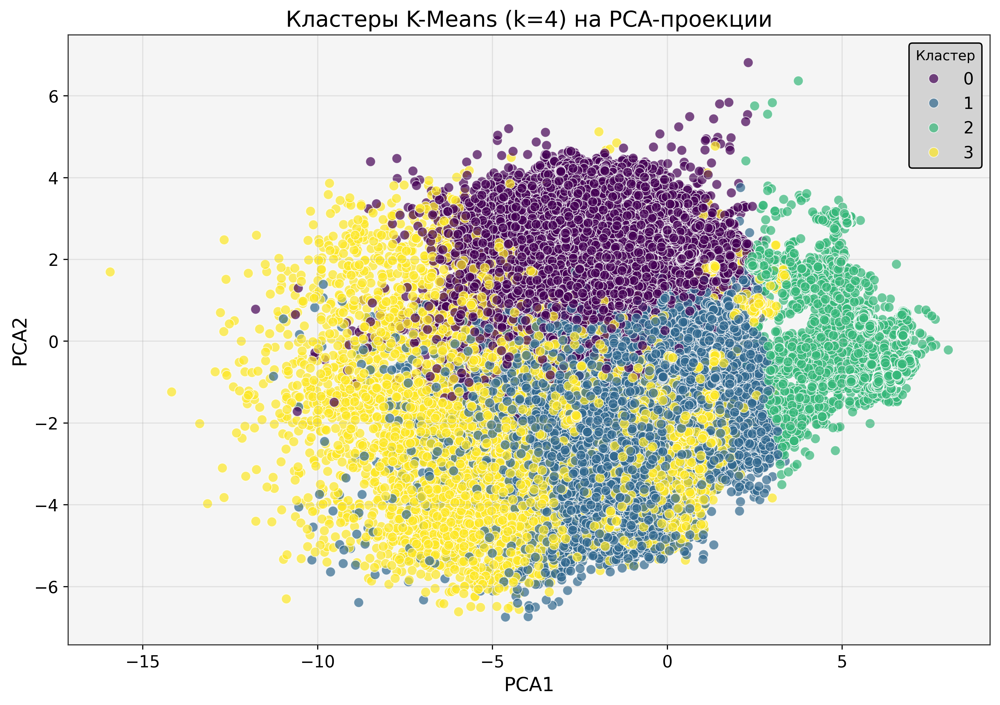

In [12]:
# --- Визуализация кластеров K-Means ---
plt.figure(figsize=(12, 8))
sns.scatterplot(x='PCA1', y='PCA2', hue='KMeans_Labels', data=X_pca_df, palette='viridis', s=50, alpha=0.7)
plt.title(f'Кластеры K-Means (k={optimal_k}) на PCA-проекции')
plt.legend(title='Кластер')
plt.show()


In [13]:
# --- Оценка качества кластеризации K-Means на выборке ---

# Определяем размер выборки.
sample_size = 70000

# Создаем случайную выборку из масштабированных данных и соответствующих меток кластеров
# resample - удобная функция из scikit-learn для создания выборок
X_sampled, labels_sampled = resample(X_scaled, kmeans_labels, 
                                     n_samples=sample_size, 
                                     random_state=42, 
                                     stratify=kmeans_labels) # стратификация сохраняет пропорции кластеров

print(f"Начинаем расчет метрик на выборке размером {sample_size}...")

kmeans_silhouette = silhouette_score(X_sampled, labels_sampled)
kmeans_calinski = calinski_harabasz_score(X_sampled, labels_sampled)
kmeans_davies = davies_bouldin_score(X_sampled, labels_sampled)

print("Расчет завершен.\n")
print(f"K-Means Silhouette Score (на выборке): {kmeans_silhouette:.3f}")
print(f"K-Means Calinski-Harabasz Score (на выборке): {kmeans_calinski:.3f}")
print(f"K-Means Davies-Bouldin Index (на выборке): {kmeans_davies:.3f}")



Начинаем расчет метрик на выборке размером 70000...
Расчет завершен.

K-Means Silhouette Score (на выборке): 0.156
K-Means Calinski-Harabasz Score (на выборке): 7384.504
K-Means Davies-Bouldin Index (на выборке): 2.507


Обучение и оценка других моделей 

Для альтеранитивы была выбрана Gaussian Mixture GMM на PyTorch с GPU.
Моделирует данные как смесь нескольких гауссовских распределений. Форма кластеров эллиптическая

In [14]:
# --- Шаг 1: Загрузка и предобработка данных ---

df = pd.read_csv(file_path)
df.fillna(df.mean(numeric_only=True), inplace=True)
X = df.drop(columns=['timestamp', 'subject_id'])
scaler = StandardScaler()
X_scaled_numpy = scaler.fit_transform(X)
print("Данные подготовлены.")


Данные подготовлены.


In [15]:
df.head()

,timestamp,handTemperature,handAcc16_1,handAcc16_2,handAcc16_3,handAcc6_1,handAcc6_2,handAcc6_3,handGyro1,handGyro2,...,ankleGyro2,ankleGyro3,ankleMagne1,ankleMagne2,ankleMagne3,ankleOrientation1,ankleOrientation2,ankleOrientation3,ankleOrientation4,subject_id
0,252.75,34.8750,0.902847,7.45872,6.032490,1.006100,7.44575,6.303650,-0.021952,0.004114,...,-0.025606,0.030239,-14.5447,27.3336,-5.76620,0.206416,0.348212,0.763201,-0.503652,5
1,3652.45,29.7500,-4.069330,3.76168,8.279720,-5.972500,3.22273,6.908970,0.116054,-0.375968,...,-0.670163,1.786200,-32.8257,-15.7719,-1.31395,0.578332,-0.566734,0.405888,-0.423791,2
2,504.76,34.3750,-2.007540,-9.60180,0.773674,-1.803500,-9.58937,1.073680,0.020131,0.042189,...,-0.009741,-0.006579,-18.8171,16.3089,25.29280,0.139776,0.676586,0.393796,0.606316,8
3,2801.61,31.9375,-13.262200,5.85443,0.899334,-13.611500,5.91511,0.840377,1.715630,-0.050492,...,-0.163470,-3.495570,-26.7418,34.3566,21.32740,0.416303,0.783387,0.306464,0.345075,2
4,441.01,33.5000,-0.013940,8.66540,4.398210,0.144153,8.56816,4.822200,-0.006938,-0.007383,...,-0.028172,-0.003737,-17.7798,-3.9981,10.99500,0.171133,-0.748343,0.252988,-0.588807,6


In [16]:
X_scaled_numpy

array([[ 1.3864424 ,  0.7587688 ,  0.58593366, ...,  0.78719195,
         1.33843174, -0.7089704 ],
       [-1.54514375,  0.05201739,  0.07221827, ..., -0.85230188,
         0.29806721, -0.53729711],
       [ 1.10043399,  0.34508278, -1.78467951, ...,  1.37560607,
         0.26285974,  1.67707362],
       ...,
       [ 1.27918925, -0.27465445, -0.1279257 , ...,  0.6971399 ,
         1.31969829,  0.70023558],
       [-2.51042212,  1.40680393,  0.9996917 , ..., -1.26797124,
        -1.0487255 , -0.9070887 ],
       [ 0.49266613, -0.68094528, -0.17173068, ..., -1.11076765,
        -0.22169723, -0.87574679]])

In [17]:
# --- Шаг 2: Подготовка данных и определение устройства ---

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

if device.type == 'cpu':
    print("Внимание: GPU не обнаружен. Вычисления будут на CPU.")
else:
    print(f"Обнаружено устройство: {torch.cuda.get_device_name(0)}")

X_gpu = torch.from_numpy(X_scaled_numpy).float().to(device)
print(f"Данные успешно перенесены на устройство: {X_gpu.device}")

Обнаружено устройство: AMD Radeon RX 7800 XT
Данные успешно перенесены на устройство: cuda:0


In [18]:
# --- Шаг 3: Кластеризация GMM на GPU с использованием tgmm ---
print("\nШаг 3: Запуск Gaussian Mixture Model (GMM) на GPU...")
optimal_k = 4
n_features = X_gpu.shape[1]

# Создаем модель, передавая устройство напрямую в конструктор, как в документации
gmm = GaussianMixture(
    n_components=optimal_k,
    n_features=n_features,
    covariance_type='diag',   # Используем диагональную матрицу для стабильности
    init_params='kmeans',     # Используем K-Means для надежной инициализации
    device=device             # <-- Правильный параметр для активации GPU
)

# Обучаем модель
gmm.fit(X_gpu, max_iter=100)

print("Кластеризация GMM на GPU завершена.")
if gmm.converged_:
    # Используем атрибут n_iter_ для получения количества итераций
    print(f"Модель сошлась за {gmm.n_iter_} итераций.")
else:
    print(f"Внимание: модель не сошлась за {gmm.max_iter} итераций.")

# Получаем метки кластеров
labels_gpu = gmm.predict(X_gpu)


Шаг 3: Запуск Gaussian Mixture Model (GMM) на GPU...
Кластеризация GMM на GPU завершена.
Модель сошлась за 17 итераций.


In [19]:
# --- Шаг 4: Оценка качества ---
print("\nШаг 4: Оценка качества кластеризации GMM...")
labels_cpu = labels_gpu.cpu().numpy()

sample_size = 70000
if len(X_scaled_numpy) > sample_size:
    try:
        # Создаем стратифицированную выборку для быстрой и точной оценки
        X_sampled, labels_sampled = resample(X_scaled_numpy, labels_cpu,
                                             n_samples=sample_size,
                                             random_state=42,
                                             stratify=labels_cpu)
    except ValueError:
        # Если стратификация не удалась, используется обычная выборка
        print("Не удалось выполнить стратификацию, используется обычная выборка.")
        indices = np.random.choice(len(X_scaled_numpy), sample_size, replace=False)
        X_sampled, labels_sampled = X_scaled_numpy[indices], labels_cpu[indices]
else:
    X_sampled, labels_sampled = X_scaled_numpy, labels_cpu


# Расчет силуэта на полном наборе данных
gmm_silhouette = silhouette_score(X_sampled, labels_sampled)

# Расчет индекса Калински-Харабаса
gmm_calinski = calinski_harabasz_score(X_sampled, labels_sampled)

# Расчет индекса Дэвиса-Болдина
gmm_davies = davies_bouldin_score(X_sampled, labels_sampled)

print("Расчет завершен.\n")
print(f"GMM Calinski-Harabasz Score (на выборке): {gmm_calinski:.3f}")
print(f"GMM Davies-Bouldin Index (на выборке): {gmm_davies:.3f}")
print(f"GMM Silhouette Score (на выборке): {gmm_silhouette:.4f}")


Шаг 4: Оценка качества кластеризации GMM...
Расчет завершен.

GMM Calinski-Harabasz Score (на выборке): 4673.016
GMM Davies-Bouldin Index (на выборке): 5.372
GMM Silhouette Score (на выборке): 0.0621


Объясненная дисперсия первыми двумя компонентами: 25.44%
Строим график кластеров...


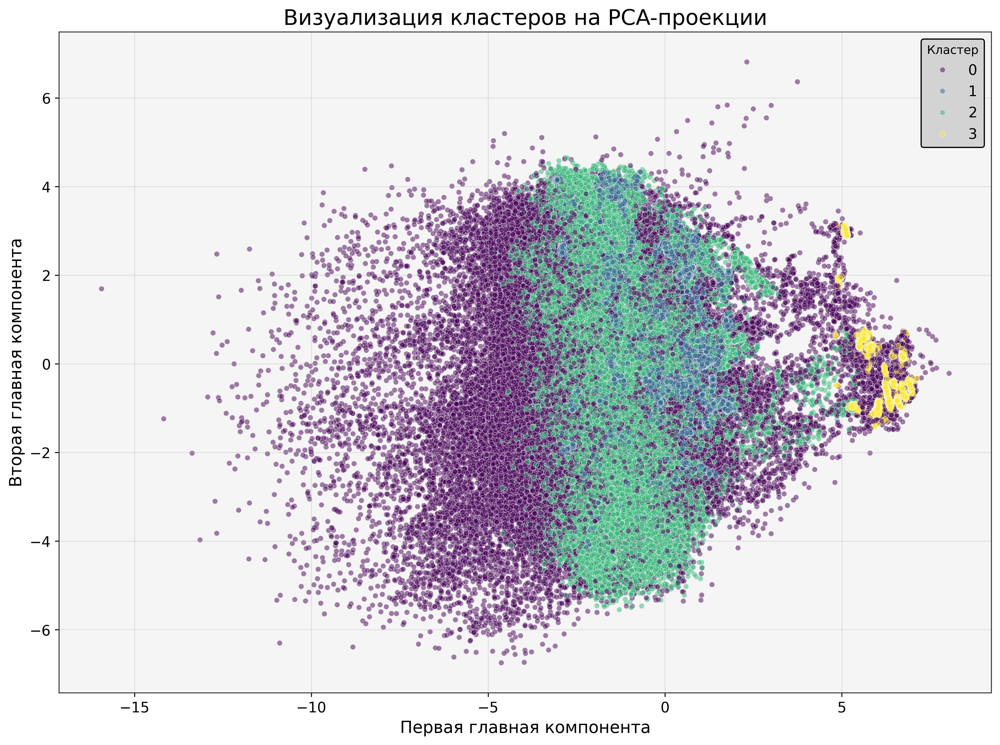

In [20]:
pca = PCA(n_components=2, random_state=42)

X_pca = pca.fit_transform(X_scaled_numpy)

# Объясненная дисперсия показывает, какой процент информации сохранили 2 главные компоненты
print(f"Объясненная дисперсия первыми двумя компонентами: {sum(pca.explained_variance_ratio_)*100:.2f}%")

# labels_cpu - это метки кластеров, полученные от модели и перенесенные на CPU
pca_df = pd.DataFrame(data=X_pca, columns=['PCA1', 'PCA2'])
pca_df['cluster'] = labels_cpu


# Построение графика
print("Строим график кластеров...")
plt.figure(figsize=(14, 10))

# Используем seaborn для красивой и информативной диаграммы рассеяния
sns.scatterplot(
    x='PCA1', y='PCA2',
    hue='cluster',         # Раскрашиваем точки по номеру кластера
    palette='viridis',     # Выбираем цветовую палитру
    data=pca_df,
    alpha=0.5,             # Делаем точки полупрозрачными, чтобы видеть плотность
    s=20                   # Устанавливаем размер точек
)

plt.title('Визуализация кластеров на PCA-проекции', fontsize=18)
plt.xlabel('Первая главная компонента', fontsize=14)
plt.ylabel('Вторая главная компонента', fontsize=14)
plt.legend(title='Кластер')
plt.grid(True)
plt.show()



### Итог

Для наглядности сведем все полученные результаты в единую таблицу.

| Метрика | K-Means | GMM | Какая модель лучше? |
| :--- | :--- | :--- | :--- |
| **Silhouette Score** (выше = лучше) | **0.156** | 0.0621 | **K-Means** |
| **Calinski-Harabasz Score** (выше = лучше) | **7384.504** | 4673.016 | **K-Means** |
| **Davies-Bouldin Index** (ниже = лучше) | **2.507** | 5.372 | **K-Means** |

### Детальный анализ результатов


#### 1. Silhouette Score (Коэффициент силуэта)

*   **K-Means (0.156) vs. GMM (0.0621):** K-Means показал результат почти в 2.5 раза лучше. Эта метрика оценивает, насколько точки близки к своему кластеру и далеки от соседних. Результат говорит о том, что кластеры, найденные K-Means, являются более четкими и определенными. Точки внутри этих кластеров более "уверены" в своей принадлежности.

#### 2. Calinski-Harabasz Score (Индекс Калински-Харабаса)

*   **K-Means (7384.5) vs. GMM (4673.0):** K-Means снова показывает значительно лучший результат[8]. Этот индекс измеряет отношение разброса *между* кластерами к разбросу *внутри* них[9]. Высокое значение у K-Means означает, что его кластеры одновременно более компактные (точки плотно сгруппированы) и при этом лучше разнесены в пространстве друг от друга.

#### 3. Davies-Bouldin Index (Индекс Дэвиса-Болдина)

*   **K-Means (2.507) vs. GMM (5.372):** Здесь побеждает модель с меньшим значением, и это снова K-Means. Этот индекс наказывает модели, у которых кластеры большие (не плотные) и при этом находятся близко друг к другу. Результат GMM более чем в два раза хуже, что подтверждает выводы других метрик: GMM создал более "размытые" и сильно пересекающиеся кластеры.

### Выводы и финальное объяснение выбора

На основе всех трех метрик **следует выбрать модель K-Means как лучшую** для решения задачи

---

Файл с результатами

In [23]:
# kmeans_labels — массив меток после кластеризации
df_sub = pd.DataFrame({
    'Index': np.arange(0, len(kmeans_labels)),
    'activityID': kmeans_labels
})

unique_labels = pd.unique(df_sub['activityID'])
label_map = {old_label: new_label for new_label, old_label in enumerate(unique_labels, start=1)}
df_sub['activityID'] = df_sub['activityID'].map(label_map)
df_sub.to_csv('submission.csv', index=False)
